# Project 1: Assembling Genomes


   <div class="alert alert-block alert-danger">
    <center>Due: <b>Tuesday, 8 February, 4:59pm</b>.</center> 
   </div>
   
   <div class="alert alert-block alert-warning">
   <center>
       <b>Collaboration and Resource Policy</b>
    </center>
    For this assignment, you are encouraged to work with one other person. Your team must satisfy the constraints mentioned in <a href="https://www.dropbox.com/s/g6z2xncwc4jsplp/csbio-class2-inked.pdf?dl=0">Class 2</a>.
    
   1. You went to different high schools.
   2. You and your partner have different answers to <em>at least one</em> of these questions:
       - What country were you born in?
       - Have you taken any biology courses at UVA?
       - Have you taken cs3102?
       - Have you taken cs4102?
    
We expect most students will have the best learning experience on this assignment by working with a partner, but if you prefer to work alone it is okay to do this assignment on your own.
    
You are permitted (actually _encouraged_) to discuss these problems with anyone you want, including other students in the class. If you do discuss the specific questions in the assignment with anyone other than your assignment partner and the course staff, though, you should list them in the _External resources used_ section below.
    
You are welcome to use any resources you want for this assignment, other than ones that would defeat the purpose of the assignment. This means you should not look at answers or code from any other students in the class (other than your collaboration with your partner), and if you find code that implements the problem you are being asked to do for the assignment, you should not use that code. You should document all external resource you use that are not part of the course materials in the _External resources used_ section below.

**Team submitting this assignment:**  
<div class="alert alert-success">
    <b><em>list each member of your team here, including both your name and UVA computing id  </em></b>  
    <div>
    Faisal Refai (ftr3vf)  
    Ife Adetunji (iaa8xt)
    </div>
</div>

**External resources used:** 
<div class="alert alert-success">
<em>It is not necessary to list the course materials, but if you used any other resources, including discussing problems with students not on your team, list them here.</em>
</div>

In this project, we will explore genome assembly — the process of determining the order of nucleotides from fragmented reads that are produced by sequencing machines. 

Genome assembly maps to a very well defined computer science problem, but can get quite complicated, as problems such as full sequence coverage, finding a good length for reads (the $k$ in $k$-mer), and sequencing errors present challenges for sequencing analysis and accuracy. For the required problems (ones everyone is expected to solve), you will be able to assume perfect coverage and no read errors; for the "challenge" problem (that is considered a bonus, and not something we expect everyone to be able to solve, and perhaps may not even be feasible for anyone to solve) you will not be able to rely on such assumptions.

 <div class="alert alert-block alert-warning">
    
<b>Submission</b>: You should work on this assignment by forking the provided Project 1 repository (you probably already did this, following the instructions posted at [https://computingbiology.github.io/project1](https://computingbiology.github.io/project1). Add the other teammate to as a collaborator with write access (also under the Settings tab) to this repository.
    
You should answer the questions and write your code in this Jupyter Notebook. (We don't expect you to need to use any external files or organize your code outside of the notebook, but if you do, make sure to put everything needed to run your code in your repository.) Parts where you are expected to provide and answer (which could be text that can be written in markdown format in the notebook or Python code that runs in the notebook) are marked in green.
        
When you are ready to submit the assignment, you should create a release of the version you are submitting ([github's directions for how to create a release](https://docs.github.com/en/repositories/releasing-projects-on-github/managing-releases-in-a-repository)) tagged as `submit`. After you've done this, send a message in slack to a channel that includes both team members (so the one sending this message should include the other team member) and all of the course staff (`dave`, `Hyun Jae Cho`, and `Anshuman Suri`) and a link to your repository (feel free to add any other useful comments if you want, but the link to your submission repository is sufficient).

## Getting Started

1. Install basic required packages, should be run only once. You may need to restart the jupyter python kernel (under the Kernel menu) after this. (You can execute this directly in the notebook but running the command below.)

In [1]:
%pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.


2. Make sure you have [graphviz](https://graphviz.org/) installed on your system. (On a Mac OS X, `brew install graphviz`. For other platforms, see [_https://graphviz.org/download/_](https://graphviz.org/download/).)

In [2]:
import collections
import matplotlib.pyplot as plt

import utils

## Part 1: Assembling the TeleTubby Genome

For this part, you're given reads generated while trying to sequence the DNA of a mysterious unknown organism with a _tiny_ genome. Some of the course staff is not sure what a TeleTubby is, but I've been assured that no cute creatures were harmed in producing this data (which was generated synthetically).

By answering the following questions, you will learn how to assemble the original genome sequence from sequence reads.

Sequencing data is often stored in the FASTQ file format, with is a simple ASCII format that is somewhat human-readable. 

In _TeleTubby.fastq_ (which is included in the repository you forked), you will find the data that was read from the TeleTubby genome. Each four lines of the file repeat the same pattern. For example,
```
@TeleTubby Genome: Project 1
TAAAATGG
+
HAICDF5I
```
The first line contains the metadata that encodes the name of the read, the experiment type, the kind of sequencing machine used, etc. 

The second line is the sequence of bases that was read. 

The third line is just a placeholder.

The fourth line is a sequence of base qualities that encodes the qualities for the corresponding bases in the sequence line. We will discuss and use this for Problem 2.

Read in the data from `TeleTubby.fastq`:

In [3]:
# Read sequence reads (error-free) from file
sequence_reads, qualities = utils.read_fastq('TeleTubby.fastq')

### Melting Temperature

The GC-content (or the ratio of G and C nucleotides) is related to the melting temperature of a DNA double helix structure. 

The following equation can be used to estimate the melting temperature (in degrees Celsius) of DNA for a particular sequence:

\begin{equation*}
t_m = 64.9+0.41(\%GC)-\frac{500}{\text{length of sequence}}
\end{equation*}

As a reference, the human genome is known to have between 35%-60% GC-content. 

<div class="alert alert-success">

**Problem 1.** Calculate the melting temperature for the TeleTubby genome using the formula above. Assume that the sequence is 300 nucleotides long, and that the provided read data has equal coverage everywhere so the G-C distribution in the reads is very close to the actual G-C distribution for the genome. 
    </div>

In [4]:
# Write code here for calculating the %GC content from the sequence_reads, and computing the estimated melting temperature.
total = 0
gc = 0
for nt in sequence_reads:
    for t in nt:
        if t == "G" or t == "C":
            gc+=1
        total+=1
gc_content = gc/total
melting_temp = 64.9 + 0.41*gc_content - (500/300)

In [5]:
# Print out temperature in Celsius
print(melting_temp)

63.44847838452788


## Interpreting Read Quality

Phred33 quality scores are represented as the character with an ASCII code equal to its value + 33 (to make them easy to print alongside genome sequences). The Phred scores $Q$ are related to error probabilities $P$ as: $Q = -10 \log_{10}(P)$. The table linked here provides a mapping from the Phred values provided in a fastq file and the $Q$ values: [Quality Score Encoding](https://support.illumina.com/help/BaseSpace_OLH_009008/Content/Source/Informatics/BS/QualityScoreEncoding_swBS.htm) 

<div class="alert alert-success">
    
**Problem 2.** Using the Phred scores, identify the _least likely to be correct_ read in the TeleTubby.fastq data, which is the read with the lowest probability that it contains _no_ errors.

</div>

In [6]:
# Write your code for Problem 2 here. 
# It should output the read (nucleotide sequence) with the lowest probability of containing no errors.
index = 0
minimum = 100
min_index = 0
for quality in qualities:
    total = 0
    for char in quality:
        q = ord(char)-33
        p = 10 ** (q/-10)
        complement = 1 - p
        total*=complement
    if total < minimum:
        minimum = total
        min_index = index
    index+=1
print(sequence_reads[min_index])
    

GCGTTGCT


Note: For the following problems, you can ignore the read quality scores, and safely assume there are no actual errors in the provided TeleTubby reads.

## Frequency analysis

Looking at repetitions in the sequence can be helpful in estimating the "redudancy" in the organisms. Eucaryote genomes have a lot of redundancy, while smaller organisms like bacteria have highly packed genomes. One heuristic to estimate this before actually performing the assembly could be looking at how often certain $k$-mers are repeated.

<div class="alert alert-success">
    
**Problem 3.**
    Print out the 3 most frequent <em>k</em>-mers in the TeleTubby reads with their frequencies. (As in Problem 1, doing this from the reads only produces the same result as from the genome if the read coverage is equal everywhere, but it should be a close estimate.)
</div>

In [7]:
# Your code here
## Assume that k=8 since sequence reads are length 8
map = {}
for kmer in sequence_reads:
    if kmer in map:
        map[kmer]+=1
    else:
        map[kmer]=1
sorted_map = sorted(map.items(), key=lambda kv: kv[1])
print(sorted_map[len(sorted_map)-1])
print(sorted_map[len(sorted_map)-2])
print(sorted_map[len(sorted_map)-3])

## Code for finding any value of k most frequent k-mer

# map = {}
# genome = ""
# for read in sequence_reads:
#     genome+=read
# start = 0
# end = 3 ## k-value
# while end < len(genome):
#     kmer = genome[start:end]
#     if kmer in map:
#         map[kmer]+=1
#     else:
#         map[kmer] = 1
#     start+=1
#     end+=1
# sorted_map = sorted(map.items(), key=lambda kv: kv[1])
# print(sorted_map[len(sorted_map)-1])
# print(sorted_map[len(sorted_map)-2])
# print(sorted_map[len(sorted_map)-3])

('ATGATGAT', 3)
('TGATGATG', 2)
('GATGATGA', 2)


## Greedy Assembly

Given a set of sequence fragments, the objective of assembly can be viewed as finding the shortest sequence that contains all the fragments.

One of the approaches to assemble the genome from the given reads is a greedy algorithm:

```
while (len(fragments) > 1):
   calculate pairwise alignments of all pairs of fragments
   merge the two fragments with the largest overlap
genome = fragment[0] # the single remaining fragment is the genome
```


<div class="alert alert-success">
    
**Problem 4 (a)**. What would the runtime be of this algorithm, given $n$ $k$-mer reads? (If you are not sure how to express your answer to this question, review [_Cost of Computation_](https://computingbiology.github.io/complexity/).)
    </div>

<i>Answer</i>: The runtime of this algorithm would be O(n^2). Despite being a divide and conquer algorithm, in order to make the decision on which elements to combine it compares all possible pairs. That means in the first iteration it is comparing all possible pairings. Thus on the first iteration prior to any combinations it is doing n^2 comparisons to determine the merge. Merging the fragments would be similar to the merge method in merge sort having a runtime of O(log n) but since the step comes after the pairwise alignment calculation it does not effect the overall runtime. The full runtime would be O(n^2 + log n) which after taking the highest term in O(n^2).

<div class="alert alert-success">

**Problem 4 (b)**. Is this algorithm guaranteed to find the correct genome? (A good answer will define what _correct_ means here, and explain why the algorithm is or is not guaranteed to find it.)

<i>Answer</i>: No this algorithm is not guarenteed to find the correct genome. I am defining correct as the resulting genome is identical in order of the nucleotides as the orginal genome. I am assuming that in order to find the correct genome it must first choose & calculate the correct shortest sequence. The way I understand the algorithm is that it continues to merge the two reads(that are able to be merged) with overlap but sometimes that choice doesn't result in the original genome because if two items has the same amount of overlap then order would matter. The algorithm has no specification for order on the same frequency. I put a counter example below where the order would matter.  

Example:

Genome: ATGGTATGGC

Sequence Reads: ATGG   
                TGGT  
                TATG  
                TGGC  

Algorithm Result:   
ATGG --  
-------| --> ATGGC  
TGGC --  
TATG  
TGGT  
  
ATGGC --  
--------| --> TATGGC  
TATG  --  
TGGT  
  
TATGGC --  
-----------| --> TGGCATGGT  
TGGT   --  
  
-----------------------------  
ATGG --  
-------| --> ATGGT  
TGGT --  
TATG  
TGGC  
  
ATGGT --  
--------| --> ATGGTATG  
TATG  --  
TGGC  
  
ATGGTATG --  
-----------| --> ATGGTATGGC  
TGGC   --  
  
  
We can see that depending on the option chosen the orginal genome answer comes out different. In the first example I chose the intial combination to be ATGG and TGGC but in the second example I chome ATGG and TGGT. Both have an overlap of 3 but the leftover choices affect the ultimate decision which is why a greedy algorithm cannot be used. 

## Graph-based Assemblyz

Graphs for genome assembly can be constructed in two ways:

- de Bruijn graph: Processing $k-$mers as edges, with $(k-1)-$mers as nodes, and
- Overlap graph: Processing $k-$mers as nodes, with $(k-1)-$mers as edges.

A de Bruijn graph can be processed to find Euler paths, while Overlap graphs can be processed to find Hamiltonian paths. Both of these methods can be used reconstruct the original genome.

<div class="alert alert-success">
    
**Problem 5.**  Use one of these two techniques to reconstruct the TeleTubby genome from the provided sequence reads. 
    
</div>
    
We have provided some template code below that may be helpful (but feel free to ignore this is you prefer).

In [8]:
# Read reads into graph
def build_graph(k_mers):
    edges = []
    nodes = set()
    # Your code here
    for node in k_mers:
        dB_node = node[0:7]
        dB_node1 = node[1:]
        nodes.add(dB_node)
        nodes.add(dB_node1)
        edge = (dB_node, dB_node1)
        if edge not in edges:
            edges.append((dB_node, dB_node1))
    return nodes, edges

In [9]:
nodes, edges = build_graph(sequence_reads)

In [10]:
# Needed to properly visualize graphs
%load_ext gvmagic

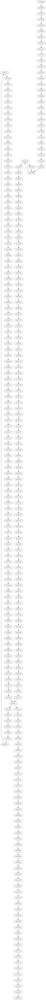

In [11]:
# Helper function to visualize graphs
%dotstr utils.viz_graph(nodes, edges)

In [12]:
# Main assembly algorithm

def assemble_sequence(nodes, edges, start):
    assembled_sequence = ""
    # Your code here
    graph = {}
    for edge in edges:
        node = edge[0]
        if node in graph:
            graph[node].append(edge[1])
        else:
            graph[node] = [edge[1]]  
    kmer_list = []
    kmer_list.append(start)
    node_available = True
    while(node_available):
        temp_list = []
        current = start
        #Build list for any node and start cancelling out visited edges and nodes with all visited edges
        while(current in graph):
            new_node = graph[current].pop()
            if(len(graph[current]) == 0):
                graph.pop(current)
            temp_list.append(new_node)
            current = new_node
        # temp list for the nodes with 2 edges and append 
        # it to the correct section of the the final 
        index = kmer_list.index(start)
        kmer_list = kmer_list[0:index+1] + temp_list + kmer_list[index+1:len(kmer_list)]
        # Check if there are any more nodes in the graph with unvisited edges
        node_available = False
        for n in kmer_list:
            if n in graph:
                start = n
                node_available = True
    #Assemble the sequence removing the overlap
    if len(kmer_list) == 0:
        return ""
    assembled_sequence = kmer_list[0]
    for node in kmer_list:
        assembled_sequence += node[-1]
    return assembled_sequence

In [280]:
# Output assembled sequence
# Hint: Sequence is 300 nucleotides long

assembled_seq = assemble_sequence(nodes, edges, "CTCGAAT")
assembled_seq

'CTCGAATTCGTAAACGTGTGAATGTGTGATATGATGATTGATGAGTCCGATACGGGCGGATTCTGACGCAAAGCATCACCCCGTCGGGGTAAAAGAGCCTGACGACCGTGAGCATATGTCAGCATTTACCGGCGTTGCTCCCGACTTGTGCTCACCTGACAACATTAGGCAGGATAAGCTTATGAGATGACGCCCCCCCAGTGGTCAGATTTCCATCCCTGAGGATTTCGGTAGGACAATTTACCCATCGCGCGCCAGGGGTCGTAGGTAGAATTGCTCGGAGCCACCAGACCTGGA'

<div class="alert alert-success"> 
    
**Problem 6.** Which of the two assembly methods did you use for problem 5, and why? (Hint: consider how the costs scale with the number of reads.)
    
</div>

Answer: I chose de Brujin because it uses Eulerian path. The Eulerian path checks that each edge is visited once whereas in Hamiltonian each vertex is visited once but edges can be visited multiple times. If we think about the graph we are creating based on the reads we are guarenteed to have a connected graph. Thus by visiting each edge we will be visiting each vertex at least once as well. However, we will not revisit edges. In terms of cost scale, as the number of reads increases, the number of nodes is likely to increase (could be a lot of repeats). Since the overlapping graph will do more work if the number of nodes increases that means the de Brujin scales better in terms of costs of computing with reads. Thus I chose the de brujin method. It also seemed a little more intuitive to make the combination of the nodes to be the edge. 

## Part 2: Sequencing SARS-CoV-2 virus

Let's move on from TeleTubbies to real-world organisms. For this problem, you'll assemble a genome for a variant of the SARS-CoV-2 virus. You're given reads from <i>actual</i> genome sequencing runs in the provided `SARS-CoV2.fastq` file. The file is based on the first Covid genome that was submitted on 5 January 2020: [https://www.ncbi.nlm.nih.gov/nuccore/NC_045512](https://www.ncbi.nlm.nih.gov/nuccore/NC_045512) But, you should be reconstructing a sequence from the provided reads without looking at the source sequence.

<div class="alert alert-success">
    
**Problem 7.**  Reconstruct the SATS-CoV2 genome from the provided sequence reads using $k=25$. 
    
</div>

You can re-use your implementation from Problem 5 and simply run it on the new data (depending on what you did for Problem 5, that might be enough to solve this problem). 

Print out your reconstructed sequence to a file `output.txt` (and add this file to the repo you submit). For this part, we will still assume that all the reads are error-free. 

In [252]:
# Read sequence reads
sequence_reads_covid, qualities_covid = utils.read_fastq('SARS-CoV2.fastq')

In [253]:
# Read reads into graph
def build_graph2(k_mers):
    edges = []
    nodes = set()
    # Your code here
    for node in k_mers:
        dB_node = node[0:24]
        dB_node1 = node[1:]
        nodes.add(dB_node)
        nodes.add(dB_node1)
        edge = (dB_node, dB_node1)
        if edge not in edges:
            edges.append((dB_node, dB_node1))
    return nodes, edges
nodes_covid, edges_covid = build_graph2(sequence_reads_covid)

In [258]:
%dotstr utils.viz_graph(nodes_covid, edges_covid)

In [273]:
# Call main assembly algorithm
def assemble_sequence2(nodes, edges, start):
    assembled_sequence = ""
    # Your code here
    graph = {}
    for edge in edges:
        node = edge[0]
        if node in graph:
            graph[node].append(edge[1])
        else:
            graph[node] = [edge[1]]  
    kmer_list = []
    kmer_list.append(start)
    node_available = True
    while(node_available):
        temp_list = []
        current = start
        #Build list for any node and start cancelling out visited edges and nodes with all visited edges
        while(current in graph):
            new_node = graph[current].pop()
            
            if(len(graph[current]) == 0):
                graph.pop(current)
                
            temp_list.append(new_node)
            current = new_node
        # temp list for the nodes with 2 edges and append 
        # it to the correct section of the the final 
        index = kmer_list.index(start)
        kmer_list = kmer_list[0:index+1] + temp_list + kmer_list[index+1:len(kmer_list)]
        # Check if there are any more nodes in the graph with unvisited edges
        node_available = False
        for n in kmer_list:
            if n in graph:
                start = n
                node_available = True
    #Assemble the sequence removing the overlap
    if len(kmer_list) == 0:
        return ""
    assembled_sequence = kmer_list[0]
    for node in kmer_list:
        assembled_sequence += node[-1]
    return assembled_sequence
assmebled_covid_seq = assemble_sequence2(nodes_covid, edges_covid, "ATTAAAGGTTTATACCTTCCCAGG")

In [274]:
# Write assembled sequence to file
with open("output.txt", "w") as f:
    f.write(assmebled_covid_seq)

# Part 3: Error-Aware Assembly (Challenge Problem)

<div class="alert alert-warning">
    This problem is a "Challenge Problem". This means it is a problem of unknown difficulty that might be quite challenging (unlike the earlier problems, we don't have a reference solution for this one, or a clear idea how hard it might be). We do hope all students will at least attempt this and that more ambitious students will work hard to solve it and learn interesting things by the attempt (whether or not it is successful), but not get frustrated if you can't get to the desired answer.  As a "Challenge Problem" it means that you shouldn't be worried if you are not able to solve this, though, and you can get full expected credit on this assignment without answering it.
</div>


In the parts above, we assumed error-free reads while assembling $k$-mers. As much as we'd like that, actual reads can (and do) have errors, captured by their Phred scores. 

For this question, you're given raw, actual reads from sequencing runs. Download the reads from this file:
https://sra-pub-sars-cov2.s3.amazonaws.com/sra-src/SRR11528307/ABS2-LN-R1_cleaned_paired.fastq.gz.  


<div class="alert alert-success">
    
**Problem 8 (Challenge).** Give the reads in the linked fastq file above, including their Phred33 quality score, assemble the most likely genome. Your solution should output the assembled sequence in `challenge.txt`. Provide a brief explantion of how your algorithm works and interesting things you learned in developing it.
    
</div>
    
This is an open-ended question. You are free to use any approach to deal with the issue. Make sure you provide your code, along with any assumptions you may have.

_Write a description of your algorithm, and things you learned from working on this here._

Description: I am not really sure if I am misreading the question but if we have the sequence reads then we should be able to break those down into k-mers then applying de brujin's algorithm with the Eulerian path to reassemble the genome. My algorithm is almost the same as problems 5 & 7 where I find the eulerian path for the node to edge graph I create then once that path incorporates all the edges, I use that path to assemble the genome sequence. The problem was the sequence read was too large causing the algorithm to be too slow. So I also tried instead I tried breaking down the problem into a potential repetitive segment that could be futher used to build the genome. I tried used k=3 because those are amino acids and we know there are only 20 of those. So once I have a list of the 20 from the sequence I could rebuild then find the repetitition. However, I quickly realized that I am losing the order of the sequence by taking random parts and it will never match the original. I don't know how to do this problem efficiently enough in a different way that 151 sized sequence reads will work. 

In [ ]:
# implementation
sequence_reads_challenge, qualities_challenge = utils.read_fastq('challenge.fastq')
##print(len(sequence_reads_challenge[1])) ## 151
#k_mers = set()
#for read in sequence_reads:
#    start = 0
#    end = 3
#    while end < 151:
#        if end != 150 and len(read[start:end]):
#            k_mers.add(read[start:end])
#        start+=3
#        end+=3
#    if len(k_mers) >= 20:
#        break
#print(k_mers)

# Read reads into graph
def build_graph3(k_mers):
    edges = []
    nodes = set()
    i=0
    start_challenge=None
    # Your code here
    for node in k_mers:
        dB_node = node[0:151]
        dB_node1 = node[1:]
        nodes.add(dB_node)
        nodes.add(dB_node1)
        edge = (dB_node, dB_node1)
        if edge not in edges:
            edges.append((dB_node, dB_node1))
        if i == 0:
            start = dB_node
            i+=1
    return nodes, edges
nodes_challenge, edges_challenge, start_challenge = build_graph3(sequence_reads_challenge)

# Call main assembly algorithm
def assemble_sequence3(nodes, edges, start):
    assembled_sequence = ""
    # Your code here
    graph = {}
    for edge in edges:
        node = edge[0]
        if node in graph:
            graph[node].append(edge[1])
        else:
            graph[node] = [edge[1]]  
    kmer_list = []
    kmer_list.append(start)
    node_available = True
    while(node_available):
        temp_list = []
        current = start
        #Build list for any node and start cancelling out visited edges and nodes with all visited edges
        while(current in graph):
            new_node = graph[current].pop()
            
            if(len(graph[current]) == 0):
                graph.pop(current)
                
            temp_list.append(new_node)
            current = new_node
        # temp list for the nodes with 2 edges and append 
        # it to the correct section of the the final 
        index = kmer_list.index(start)
        kmer_list = kmer_list[0:index+1] + temp_list + kmer_list[index+1:len(kmer_list)]
        # Check if there are any more nodes in the graph with unvisited edges
        node_available = False
        for n in kmer_list:
            if n in graph:
                start = n
                node_available = True
    #Assemble the sequence removing the overlap
    if len(kmer_list) == 0:
        return ""
    assembled_sequence = kmer_list[0]
    for node in kmer_list:
        assembled_sequence += node[-1]
    return assembled_sequence

assembled_sequence_challenge = assemble_sequence3(nodes_challenge, edges_challenge, start_challenge)
#assembled_sequence_challenge
# Write assembled sequence to file
with open("challenge.txt", "w") as f:
    f.write(assembled_sequence_challenge)

In [ ]:
%dotstr utils.viz_graph(nodes_challenge, edges_challenge)

   <div class="alert alert-block alert-danger">
    <center>
        
 **Remember to follow the submission directions above to submit your assignment by 4:59pm on Tuesday, 8 February.**
    
 </center>
 </div>